# R7 - Explainability Analysis with Concept Activation Maps

In this notebook, we'll explore the explainability of our three trained flower similarity models (both original and robust versions) using Concept Activation Maps (CAMs). We'll adapt pixel attribution methods for embedding outputs to understand what visual features our models focus on for similarity decisions.

## Project Overview

Building on our previous implementations, we'll:

1. Load all six models (original and robust versions)
2. Implement concept activation mapping for embedding-based similarity models
3. Create visual explanations for similarity decisions
4. Compare explanation patterns between original and robust models
5. Analyze concept activation differences across different flower classes

The goal is to understand how our models make similarity decisions and whether adversarial training changes their focus patterns.

## Section 1: Environment Setup

First, let's install the necessary packages and import the required libraries.

In [1]:
# Install necessary packages
!pip install torch torchvision timm matplotlib seaborn scikit-learn pandas grad-cam opencv-python

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 63.4 MB/s eta 0:00:00:00:010:01
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.5 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 55.5 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 50.4 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 35.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.5 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 7.8 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 19.6 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 12.3 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 7.8 

In [2]:
!gdown 1BKrro7PKl8M_OL4lHXibMuI7GgOzhxYe
!gdown 1WXgSpuGzVnS8Jt0bvCM9x7tn0JERVfDM
!gdown 1wx_CfOF6U3RhphJHTq2RaVitppvxo-b0
!gdown 1GAm34P3okRLmC_UP9JcV_5u75UQ1UUr5
!gdown 1dmy2bFZAxclL_dqasMHdEJ90HQtdXCni
!gdown 1Sm7UUNCsR_w5ziCHUiXkGIbTlggAsktF

Downloading...
From (original): https://drive.google.com/uc?id=1BKrro7PKl8M_OL4lHXibMuI7GgOzhxYe
From (redirected): https://drive.google.com/uc?id=1BKrro7PKl8M_OL4lHXibMuI7GgOzhxYe&confirm=t&uuid=12666e24-4256-4e7a-882a-8ed2900c246d
To: /kaggle/working/best_model_center_loss.pth
100%|███████████████████████████████████████| 60.0M/60.0M [00:00<00:00, 190MB/s]
Downloading...
From (original): https://drive.google.com/uc?id=1WXgSpuGzVnS8Jt0bvCM9x7tn0JERVfDM
From (redirected): https://drive.google.com/uc?id=1WXgSpuGzVnS8Jt0bvCM9x7tn0JERVfDM&confirm=t&uuid=3dff0146-235d-44ab-969e-efc8c7a87264
To: /kaggle/working/best_model_siamese_network.pth
100%|███████████████████████████████████████| 60.9M/60.9M [00:00<00:00, 197MB/s]
Downloading...
From (original): https://drive.google.com/uc?id=1wx_CfOF6U3RhphJHTq2RaVitppvxo-b0
From (redirected): https://drive.google.com/uc?id=1wx_CfOF6U3RhphJHTq2RaVitppvxo-b0&confirm=t&uuid=56e650ab-0845-40c4-9320-a2eac3f95613
To: /kaggle/working/best_model_triplet_lo

In [3]:
# Import necessary libraries
import os
import glob
import time
import random
import json
import warnings
from pathlib import Path

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
import cv2
from tqdm.notebook import tqdm

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torchvision
from torchvision import transforms

# Import timm for model backbones
import timm

# Import grad-cam for explainability
from pytorch_grad_cam import GradCAM, ScoreCAM, GradCAMPlusPlus, AblationCAM, XGradCAM, EigenCAM, EigenGradCAM, LayerCAM, FullGrad
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image, preprocess_image

# Suppress warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')

# Set plot style
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_theme(style="whitegrid")

# Enable inline plotting
%matplotlib inline

In [4]:
# Set global seeds for reproducibility
def set_seeds(seed=42):
    """Set seeds for reproducibility."""
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

set_seeds(42)

# Set global configuration
CONFIG = {
    'output_dir': 'output',
    'model_dir': '.',
    'robust_model_dir': '.',
    'explanation_dir': 'explanations',
    
    # Model parameters
    'image_size': 224,
    'embedding_dim': 512,
    'num_classes': 102,
    
    # Explainability parameters
    'cam_methods': ['GradCAM', 'GradCAMPlusPlus', 'ScoreCAM', 'EigenCAM'],
    'target_layer_names': {
        'tiny_vit': ['blocks', -1],  # Last transformer block
        'resnet': ['layer4', -1],    # Last residual block
        'efficientnet': ['blocks', -1]  # Last efficient block
    },
    
    # Visualization parameters
    'num_samples': 8,
    'num_concepts': 5,  # Number of concept images per class
    
    # Other settings
    'device': torch.device('cuda' if torch.cuda.is_available() else 'cpu'),
}

print(f"Using device: {CONFIG['device']}")

# Create output directories
os.makedirs(CONFIG['output_dir'], exist_ok=True)
os.makedirs(CONFIG['explanation_dir'], exist_ok=True)

Using device: cuda


## Section 2: Dataset and Model Loading

Let's load the dataset and all our trained models (both original and robust versions).

In [5]:
# Check if dataset files exist, download if necessary
if not os.path.exists('imagelabels.mat') or not os.path.exists('setid.mat'):
    print("Downloading dataset files...")

    if not os.path.exists('102flowers.tgz'):
        !wget https://www.robots.ox.ac.uk/~vgg/data/flowers/102/102flowers.tgz

    if not os.path.exists('imagelabels.mat'):
        !wget https://www.robots.ox.ac.uk/~vgg/data/flowers/102/imagelabels.mat

    if not os.path.exists('setid.mat'):
        !wget https://www.robots.ox.ac.uk/~vgg/data/flowers/102/setid.mat

    if not os.path.exists('jpg'):
        !tar -xzf 102flowers.tgz

    print("Download and extraction complete.")
else:
    print("Dataset files already exist.")

--2025-07-23 01:07:37--  https://www.robots.ox.ac.uk/~vgg/data/flowers/102/102flowers.tgz
Resolving www.robots.ox.ac.uk (www.robots.ox.ac.uk)... 129.67.94.2
Connecting to www.robots.ox.ac.uk (www.robots.ox.ac.uk)|129.67.94.2|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://thor.robots.ox.ac.uk/flowers/102/102flowers.tgz [following]
--2025-07-23 01:07:39--  https://thor.robots.ox.ac.uk/flowers/102/102flowers.tgz
Resolving thor.robots.ox.ac.uk (thor.robots.ox.ac.uk)... 129.67.95.98
Connecting to thor.robots.ox.ac.uk (thor.robots.ox.ac.uk)|129.67.95.98|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 344862509 (329M) [application/octet-stream]
Saving to: ‘102flowers.tgz’

102flowers.tgz      100%[===================>] 328.89M  29.0MB/s    in 12s     

2025-07-23 01:07:52 (26.6 MB/s) - ‘102flowers.tgz’ saved [344862509/344862509]

--2025-07-23 01:07:52--  https://www.robots.ox.ac.uk/~vgg/data/flowers/102/imagelabels

In [6]:
# Load dataset (reusing code from previous notebooks)
def load_mat(filepath):
    """Load MAT file with fallback to h5py for newer MAT file formats."""
    try:
        from scipy.io import loadmat
        return loadmat(filepath)
    except:
        import h5py
        with h5py.File(filepath, 'r') as f:
            data = {key: value[:] for key, value in f.items()}
        return data


# Load image labels and dataset split information
image_labels = load_mat("imagelabels.mat")
setid = load_mat("setid.mat")

# Extract labels and dataset splits
labels = image_labels["labels"]
train_ids = setid["tstid"].flatten() if "tstid" in setid else setid["tst"].flatten()
validation_ids = setid["valid"].flatten()
test_ids = setid["trnid"].flatten() if "trnid" in setid else setid["trn"].flatten()

# Get list of all image files and associate them with labels
image_dir = Path("jpg")
image_paths = sorted(list(image_dir.glob('image_*.jpg')),
                    key=lambda x: int(x.stem.split('_')[1]))

# Create DataFrame
image_info = []
for img_path in image_paths:
    img_id = int(img_path.stem.split('_')[1])
    if img_id <= len(labels[0]):
        label = labels[0, img_id-1]
        if img_id in train_ids:
            dataset_split = 'train'
        elif img_id in validation_ids:
            dataset_split = 'validation'
        elif img_id in test_ids:
            dataset_split = 'test'
        else:
            dataset_split = 'unknown'

        image_info.append({
            'image_id': img_id,
            'path': str(img_path),
            'label': int(label),
            'split': dataset_split
        })

image_df = pd.DataFrame(image_info)
print(f"Loaded {len(image_df)} images from {len(image_df['label'].unique())} classes")
print(f"Split distribution: {image_df['split'].value_counts().to_dict()}")

Loaded 8189 images from 102 classes
Split distribution: {'train': 6149, 'validation': 1020, 'test': 1020}


In [7]:
# Model architectures (reusing from previous notebooks)
class CenterLoss(nn.Module):
    """Center Loss implementation"""
    def __init__(self, num_classes, feature_dim, use_gpu=True):
        super(CenterLoss, self).__init__()
        self.num_classes = num_classes
        self.feature_dim = feature_dim
        self.use_gpu = use_gpu
        
        if self.use_gpu:
            self.centers = nn.Parameter(torch.randn(self.num_classes, self.feature_dim).cuda())
        else:
            self.centers = nn.Parameter(torch.randn(self.num_classes, self.feature_dim))

    def forward(self, x, labels):
        batch_size = x.size(0)
        distmat = torch.pow(x, 2).sum(dim=1, keepdim=True).expand(batch_size, self.num_classes) + \
                  torch.pow(self.centers, 2).sum(dim=1, keepdim=True).expand(self.num_classes, batch_size).t()
        distmat.addmm_(x, self.centers.t(), beta=1, alpha=-2)

        classes = torch.arange(self.num_classes).long()
        if self.use_gpu: classes = classes.cuda()
        labels = labels.unsqueeze(1).expand(batch_size, self.num_classes)
        mask = labels.eq(classes.expand(batch_size, self.num_classes))

        dist = distmat * mask.float()
        loss = dist.clamp(min=1e-12, max=1e+12).sum() / batch_size
        return loss

class CenterLossNetwork(nn.Module):
    """Center Loss Network for flower classification"""
    def __init__(self, backbone_name='resnet18', pretrained=True, num_classes=102, 
                 embedding_dim=512, training_mode='transfer_learning'):
        super(CenterLossNetwork, self).__init__()
        
        self.backbone = timm.create_model(backbone_name, pretrained=pretrained, num_classes=0)
        
        with torch.no_grad():
            dummy_input = torch.zeros(1, 3, 224, 224)
            backbone_output_dim = self.backbone(dummy_input).shape[1]
        
        self.embedding = nn.Sequential(
            nn.Linear(backbone_output_dim, embedding_dim),
            nn.BatchNorm1d(embedding_dim),
            nn.ReLU(inplace=True)
        )
        
        self.classifier = nn.Linear(embedding_dim, num_classes)
        self.training_mode = training_mode
        
    def forward(self, x):
        features = self.backbone(x)
        embeddings = self.embedding(features)
        logits = self.classifier(embeddings)
        return logits, embeddings
    
    def get_embedding(self, x):
        with torch.no_grad():
            features = self.backbone(x)
            embeddings = self.embedding(features)
            return F.normalize(embeddings, p=2, dim=1)
    
    def compute_similarity(self, img1, img2):
        embed1 = self.get_embedding(img1)
        embed2 = self.get_embedding(img2)
        similarity = torch.sum(embed1 * embed2, dim=1)
        return torch.sigmoid(similarity * 5)

class SiameseNetwork(nn.Module):
    """
    Siamese Network architecture for image similarity tasks.
    Uses a shared backbone network to extract features from both images,
    then computes similarity between the extracted features.
    """
    def __init__(self, backbone_name='resnet18', pretrained=True, embedding_dim=None, training_mode='transfer_learning'):
        """
        Initialize the Siamese network.

        Args:
            backbone_name: Name of the backbone network from timm
            pretrained: Whether to use pretrained weights
            embedding_dim: Dimension of the embedding layer (None to skip embedding)
            training_mode: One of 'full_training', 'fine_tuning', 'transfer_learning'
        """
        super(SiameseNetwork, self).__init__()

        # Create backbone network from timm
        self.backbone = timm.create_model(
            backbone_name,
            pretrained=pretrained,
            num_classes=0  # Remove classification head
        )

        # Apply training mode settings
        self.training_mode = training_mode
        self._apply_training_mode()

        # Get the output dimension of the backbone
        # For testing the output dimension, pass a dummy input through the backbone
        with torch.no_grad():
            dummy_input = torch.zeros(1, 3, CONFIG['image_size'], CONFIG['image_size'])
            backbone_output_dim = self.backbone(dummy_input).shape[1]

        print(f"Backbone: {backbone_name}, Output dimension: {backbone_output_dim}")
        print(f"Training mode: {training_mode}")

        # Optional embedding layer
        self.embedding_dim = embedding_dim
        if embedding_dim is not None:
            self.embedding = nn.Sequential(
                nn.Linear(backbone_output_dim, embedding_dim),
                nn.BatchNorm1d(embedding_dim),
                nn.ReLU(inplace=True)
            )
            final_dim = embedding_dim
        else:
            self.embedding = nn.Identity()
            final_dim = backbone_output_dim

        # Similarity head
        self.similarity_head = nn.Sequential(
            nn.Dropout(0.5),
            nn.Linear(final_dim, 256),
            nn.BatchNorm1d(256),
            nn.ReLU(inplace=True),

            nn.Dropout(0.5),
            nn.Linear(256, 64),
            nn.BatchNorm1d(64),
            nn.ReLU(inplace=True),

            nn.Linear(64, 1),
            nn.Sigmoid()
        )

    def forward_one(self, x):
        """Forward pass for a single image"""
        features = self.backbone(x)
        embedding = self.embedding(features)
        return embedding

    def _apply_training_mode(self):
        """Apply the selected training mode to the network"""
        if self.training_mode == 'transfer_learning':
            # Freeze the entire backbone
            for param in self.backbone.parameters():
                param.requires_grad = False
            print("Transfer learning mode: backbone frozen, only training embedding and similarity head")

        elif self.training_mode == 'fine_tuning':
            # Freeze early layers, train later layers
            # This is a common approach for fine-tuning
            layers_to_freeze = []

            # Handle different model architectures
            if hasattr(self.backbone, 'stem'):
                # Vision transformer style models often have a stem
                layers_to_freeze.append('stem')

            if hasattr(self.backbone, 'stages') and len(self.backbone.stages) > 2:
                # For models with stages (like RegNet, ConvNext, etc.)
                # Freeze early stages, keep later ones trainable
                early_stages = len(self.backbone.stages) // 2
                for i in range(early_stages):
                    layers_to_freeze.append(f'stages.{i}')

            elif hasattr(self.backbone, 'layer1'):
                # ResNet style models
                layers_to_freeze.extend(['conv1', 'bn1', 'act1', 'maxpool', 'layer1', 'layer2'])

            elif hasattr(self.backbone, 'blocks') and len(self.backbone.blocks) > 4:
                # Vision transformer style with blocks
                block_count = len(self.backbone.blocks)
                blocks_to_freeze = block_count // 2
                for i in range(blocks_to_freeze):
                    layers_to_freeze.append(f'blocks.{i}')

            # Apply freezing
            for name, param in self.backbone.named_parameters():
                param.requires_grad = True  # Default to trainable
                for layer_name in layers_to_freeze:
                    if layer_name in name:
                        param.requires_grad = False
                        break

            print(f"Fine-tuning mode: {len(layers_to_freeze)} early layers/blocks frozen, later layers trainable")

        else:  # full_training
            # Train the entire network
            for param in self.backbone.parameters():
                param.requires_grad = True
            print("Full training mode: all layers trainable")

    def forward(self, img1, img2):
        """
        Forward pass for a pair of images.

        Args:
            img1: First image tensor [B, C, H, W]
            img2: Second image tensor [B, C, H, W]

        Returns:
            similarity: Similarity score between the images [B, 1]
        """
        # Extract features from both images
        feat1 = self.forward_one(img1)
        feat2 = self.forward_one(img2)

        # Compute element-wise product of features
        combined_features = feat1 * feat2

        # Pass through similarity head
        similarity = self.similarity_head(combined_features)

        return similarity

    def get_embedding(self, x):
        """Get embeddings for a batch of images (for visualization)"""
        return self.forward_one(x)


class TripletNetwork(nn.Module):
    """Triplet Network for image similarity using triplet loss"""
    def __init__(self, backbone_name='resnet18', pretrained=True, embedding_dim=128, training_mode='transfer_learning'):
        super(TripletNetwork, self).__init__()

        self.backbone = timm.create_model(backbone_name, pretrained=pretrained, num_classes=0)

        with torch.no_grad():
            dummy_input = torch.zeros(1, 3, 224, 224)
            backbone_output_dim = self.backbone(dummy_input).shape[1]
        
        self.embedding = nn.Sequential(
            nn.Linear(backbone_output_dim, embedding_dim),
            nn.BatchNorm1d(embedding_dim),
            nn.ReLU(inplace=True)
        )
        
    def forward_one(self, x):
        features = self.backbone(x)
        embeddings = self.embedding(features)
        embeddings = F.normalize(embeddings, p=2, dim=1)
        return embeddings
        
    def forward(self, anchor, positive, negative):
        anchor_embedding = self.forward_one(anchor)
        positive_embedding = self.forward_one(positive)
        negative_embedding = self.forward_one(negative)
        return anchor_embedding, positive_embedding, negative_embedding
    
    def get_embedding(self, x):
        return self.forward_one(x)
        
    def compute_similarity(self, img1, img2):
        with torch.no_grad():
            embed1 = self.forward_one(img1)
            embed2 = self.forward_one(img2)
            embed1 = F.normalize(embed1, p=2, dim=1)
            embed2 = F.normalize(embed2, p=2, dim=1)
            similarity = torch.sum(embed1 * embed2, dim=1)
            similarity = torch.sigmoid(similarity * 5)
        return similarity

print("Model architectures defined!")

Model architectures defined!


In [10]:
# Load all trained models
def load_model(model_class, checkpoint_path, **model_kwargs):
    """Load a pretrained model from checkpoint."""
    model = model_class(**model_kwargs)
    
    if os.path.exists(checkpoint_path):
        checkpoint = torch.load(checkpoint_path, map_location=CONFIG['device'], weights_only=False)
        model.load_state_dict(checkpoint['model_state_dict'])
        print(f"Loaded model from {checkpoint_path}")
    else:
        print(f"Checkpoint not found at {checkpoint_path}, using randomly initialized model")
    
    model = model.to(CONFIG['device'])
    model.eval()
    return model

# Model configurations
model_kwargs = {
    'backbone_name': 'tiny_vit_5m_224.in1k',
    'pretrained': True,
    'embedding_dim': CONFIG['embedding_dim'],
    'training_mode': 'fine_tuning'
}

# Load original models
print("Loading original models...")
center_loss_model = load_model(
    CenterLossNetwork,
    'best_model_center_loss.pth',
    num_classes=CONFIG['num_classes'],
    **model_kwargs
)

siamese_model = load_model(
    SiameseNetwork,
    'best_model_siamese_network.pth',
    **model_kwargs
)

triplet_model = load_model(
    TripletNetwork,
    'best_model_triplet_loss.pth',
    **model_kwargs
)

# Load robust models
print("\nLoading robust models...")
robust_center_model = load_model(
    CenterLossNetwork,
    os.path.join(CONFIG['robust_model_dir'], 'robust_model_center_loss.pth'),
    num_classes=CONFIG['num_classes'],
    **model_kwargs
)

robust_siamese_model = load_model(
    SiameseNetwork,
    os.path.join(CONFIG['robust_model_dir'], 'robust_model_siamese_network.pth'),
    **model_kwargs
)

robust_triplet_model = load_model(
    TripletNetwork,
    os.path.join(CONFIG['robust_model_dir'], 'robust_model_triplet_loss.pth'),
    **model_kwargs
)

# Create model dictionary for easy access
models = {
    'center_loss': center_loss_model,
    'siamese': siamese_model,
    'triplet': triplet_model,
    'robust_center_loss': robust_center_model,
    'robust_siamese': robust_siamese_model,
    'robust_triplet': robust_triplet_model
}

print(f"\nLoaded {len(models)} models successfully!")

Loading original models...
Loaded model from best_model_center_loss.pth
Fine-tuning mode: 2 early layers/blocks frozen, later layers trainable
Backbone: tiny_vit_5m_224.in1k, Output dimension: 320
Training mode: fine_tuning
Loaded model from best_model_siamese_network.pth
Loaded model from best_model_triplet_loss.pth

Loading robust models...
Loaded model from ./robust_model_center_loss.pth
Fine-tuning mode: 2 early layers/blocks frozen, later layers trainable
Backbone: tiny_vit_5m_224.in1k, Output dimension: 320
Training mode: fine_tuning
Loaded model from ./robust_model_siamese_network.pth
Loaded model from ./robust_model_triplet_loss.pth

Loaded 6 models successfully!


## Section 3: Concept Activation Map Implementation

Now let's implement concept activation mapping adapted for our embedding-based similarity models.

In [11]:
# Model wrappers for Concept Activation Maps
class EmbeddingExtractor(nn.Module):
    """Generic wrapper to extract embeddings from our models."""
    def __init__(self, model, model_type):
        super(EmbeddingExtractor, self).__init__()
        self.model = model
        self.model_type = model_type
        
    def forward(self, x):
        if self.model_type == 'center_loss':
            _, embeddings = self.model(x)
            return embeddings
        elif self.model_type == 'siamese':
            return self.model.forward_one(x)
        elif self.model_type == 'triplet':
            return self.model.forward_one(x)
        else:
            raise ValueError(f"Unknown model type: {self.model_type}")

class SimilarityToConceptTarget:
    def __init__(self, concept_features):
        self.concept_features = concept_features
    
    def __call__(self, model_output):
        device = model_output.device
        concept_features = self.concept_features.to(device)

        if model_output.dim() == 1:
            model_output = model_output.unsqueeze(0)
        
        model_output_norm = F.normalize(model_output, p=2, dim=1)
        concept_norm = F.normalize(concept_features.unsqueeze(0), p=2, dim=1)
        
        cos_sim = torch.mm(model_output_norm, concept_norm.t()).squeeze()
        return cos_sim


class DifferenceFromConceptTarget:
    def __init__(self, concept_features):
        self.concept_features = concept_features
    
    def __call__(self, model_output):
        device = model_output.device
        concept_features = self.concept_features.to(device)

        if model_output.dim() == 1:
            model_output = model_output.unsqueeze(0)
        
        model_output_norm = F.normalize(model_output, p=2, dim=1)
        concept_norm = F.normalize(concept_features.unsqueeze(0), p=2, dim=1)
        
        cos_sim = torch.mm(model_output_norm, concept_norm.t()).squeeze()
        return -cos_sim

class ClassificationTarget:
    """Target function for classification models."""
    def __init__(self, class_idx):
        self.class_idx = class_idx
    
    def __call__(self, model_output):
        if len(model_output.shape) > 1:
            return model_output[:, self.class_idx]
        else:
            return model_output[self.class_idx]

print("CAM target classes defined!")

CAM target classes defined!


In [12]:
def get_target_layers(model, backbone_name):
    """Get appropriate target layers for CAM based on the backbone architecture."""
    if hasattr(model, "model"):
        model = model.model  # unwrap if wrapped in EmbeddingExtractor

    # Helper to get parent module of a conv layer if it's grouped
    def find_parent_module_with_conv(backbone):
        # Iterate in reversed order to find last conv layer
        for name, module in reversed(list(backbone.named_modules())):
            if isinstance(module, nn.Conv2d):
                # If depthwise (groups > 1 and groups == out_channels), return parent module
                if module.groups > 1 and module.groups == module.out_channels:
                    # Try to find parent module that contains this conv
                    # Simple heuristic: return the immediate parent module, or the module itself if no parent
                    parent_name = '.'.join(name.split('.')[:-1])
                    if parent_name:
                        parent_module = dict(backbone.named_modules()).get(parent_name, module)
                        return parent_module
                    return module
                else:
                    return module
        # fallback: return last module
        return list(backbone.modules())[-1]

    # Handle Vision Transformers or hybrid models like TinyViT
    if 'vit' in backbone_name.lower() or 'transformer' in backbone_name.lower():
        if hasattr(model.backbone, 'blocks'):
            last_block = model.backbone.blocks[-1]
            if hasattr(last_block, 'local_conv'):
                return [last_block.local_conv]  # likely a conv block, safe to use
            else:
                return [last_block]
        elif hasattr(model.backbone, 'stage3'):
            try:
                return [model.backbone.stage3.blocks[-1].local_conv]  # block, not raw conv
            except AttributeError:
                return [model.backbone.stage3.blocks[-1]]

    # Handle ResNet
    elif 'resnet' in backbone_name.lower():
        if hasattr(model.backbone, 'layer4'):
            return [model.backbone.layer4[-1]]  # whole block, not just conv

    # EfficientNet or MixNet
    elif 'efficientnet' in backbone_name.lower() or 'mixnet' in backbone_name.lower():
        if hasattr(model.backbone, 'blocks'):
            last_block = model.backbone.blocks[-1]
            if hasattr(last_block, 'local_conv'):
                return [last_block.local_conv]
            else:
                return [last_block]

    # Generic fallback: use helper to avoid raw grouped conv
    target_layer = find_parent_module_with_conv(model.backbone)
    if target_layer is not None:
        return [target_layer]

    # Final fallback
    print("Warning: No suitable conv target layer found, using last module of backbone.")
    return [list(model.backbone.modules())[-1]]


def prepare_image(image_path, image_size=224):
    """Load and preprocess image for CAM generation."""
    # Load image
    img = Image.open(image_path).convert('RGB')
    img_array = np.array(img)
    
    # Resize image
    img_resized = cv2.resize(img_array, (image_size, image_size))
    rgb_img_float = np.float32(img_resized) / 255.0
    
    # Preprocess for model input
    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    
    input_tensor = transform(rgb_img_float).unsqueeze(0)
    
    return img_array, rgb_img_float, input_tensor

def generate_concept_cam(model, model_type, image_tensor, concept_features, cam_method='GradCAM', 
                        similarity=True, backbone_name='tiny_vit_5m_224.in1k'):
    """Generate Concept Activation Map for an image given a concept."""
    
    # Create embedding extractor
    embedding_model = EmbeddingExtractor(model, model_type)
    embedding_model.eval()
    
    # Get target layers
    target_layers = get_target_layers(embedding_model, backbone_name)
    
    # Create target function
    if similarity:
        targets = [SimilarityToConceptTarget(concept_features)]
    else:
        targets = [DifferenceFromConceptTarget(concept_features)]
    
    # Select CAM method
    if cam_method == 'GradCAM':
        cam = GradCAM(model=embedding_model, target_layers=target_layers)
    elif cam_method == 'GradCAMPlusPlus':
        cam = GradCAMPlusPlus(model=embedding_model, target_layers=target_layers)
    elif cam_method == 'ScoreCAM':
        cam = ScoreCAM(model=embedding_model, target_layers=target_layers)
    elif cam_method == 'EigenCAM':
        cam = EigenCAM(model=embedding_model, target_layers=target_layers)
    else:
        raise ValueError(f"Unknown CAM method: {cam_method}")
    
    # Generate CAM
    try:
        grayscale_cam = cam(input_tensor=image_tensor.to(CONFIG['device']), targets=targets)
        if len(grayscale_cam.shape) > 2:
            grayscale_cam = grayscale_cam[0, :]
        return grayscale_cam
    except Exception as e:
        print(f"Error generating CAM: {e}")
        return np.zeros((224, 224))
    finally:
        # Clean up
        if 'cam' in locals():
            del cam

def generate_classification_cam(model, image_tensor, class_idx, cam_method='GradCAM', 
                              backbone_name='tiny_vit_5m_224.in1k'):
    """Generate CAM for classification model."""
    
    # Get target layers
    target_layers = get_target_layers(model, backbone_name)
    
    # Create target function
    targets = [ClassifierOutputTarget(class_idx)]
    
    # Select CAM method
    if cam_method == 'GradCAM':
        cam = GradCAM(model=model, target_layers=target_layers)
    elif cam_method == 'GradCAMPlusPlus':
        cam = GradCAMPlusPlus(model=model, target_layers=target_layers)
    elif cam_method == 'ScoreCAM':
        cam = ScoreCAM(model=model, target_layers=target_layers)
    elif cam_method == 'EigenCAM':
        cam = EigenCAM(model=model, target_layers=target_layers)
    else:
        raise ValueError(f"Unknown CAM method: {cam_method}")
    
    # Generate CAM
    try:
        grayscale_cam = cam(input_tensor=image_tensor.to(CONFIG['device']), targets=targets)
        if len(grayscale_cam.shape) > 2:
            grayscale_cam = grayscale_cam[0, :]
        return grayscale_cam
    except Exception as e:
        print(f"Error generating CAM: {e}")
        return np.zeros((224, 224))
    finally:
        # Clean up
        if 'cam' in locals():
            del cam

print("CAM utility functions defined!")

CAM utility functions defined!


## Section 4: Concept Selection and Preparation

Let's select representative concept images from different flower classes to use as references for our explanations.

Selected 5 concept classes:
  Class 102: 1 images
  Class 77: 1 images
  Class 73: 1 images
  Class 88: 1 images
  Class 89: 1 images


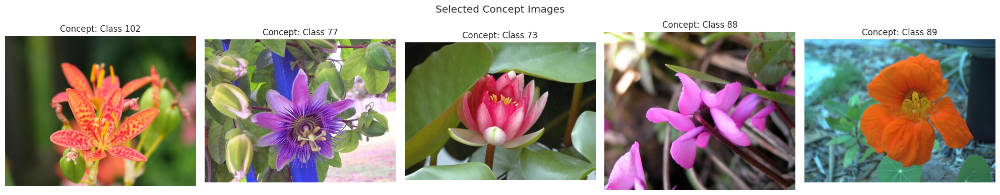

In [13]:
# Select concept images from different classes
def select_concept_images(image_df, num_concepts=5, num_images_per_concept=1, split='test'):
    """Select representative concept images from different flower classes."""
    
    # Filter by split
    split_df = image_df[image_df['split'] == split].copy()
    
    # Get the most common classes
    class_counts = split_df['label'].value_counts()
    selected_classes = class_counts.head(num_concepts).index.tolist()
    
    concept_images = {}
    
    for class_label in selected_classes:
        class_images = split_df[split_df['label'] == class_label].sample(
            min(num_images_per_concept, len(split_df[split_df['label'] == class_label]))
        )
        
        concept_images[class_label] = {
            'paths': class_images['path'].tolist(),
            'class_name': f'Class_{class_label}',
            'images': []
        }
        
        # Load and preprocess images
        for path in concept_images[class_label]['paths']:
            img_array, img_float, img_tensor = prepare_image(path)
            concept_images[class_label]['images'].append({
                'path': path,
                'array': img_array,
                'float': img_float,
                'tensor': img_tensor
            })
    
    return concept_images, selected_classes

# Select concept images
concept_images, selected_classes = select_concept_images(image_df, num_concepts=CONFIG['num_concepts'])

print(f"Selected {len(concept_images)} concept classes:")
for class_label, concept_data in concept_images.items():
    print(f"  Class {class_label}: {len(concept_data['images'])} images")

# Visualize concept images
fig, axes = plt.subplots(1, len(concept_images), figsize=(4*len(concept_images), 4))
if len(concept_images) == 1:
    axes = [axes]

for idx, (class_label, concept_data) in enumerate(concept_images.items()):
    img = concept_data['images'][0]['array']
    axes[idx].imshow(img)
    axes[idx].set_title(f'Concept: Class {class_label}')
    axes[idx].axis('off')

plt.suptitle('Selected Concept Images')
plt.tight_layout()
plt.show()

In [14]:
# Extract concept embeddings for all models
def extract_concept_embeddings(models, concept_images):
    """Extract concept embeddings from all models."""
    
    concept_embeddings = {}
    
    for model_name, model in models.items():
        print(f"Extracting embeddings for {model_name}...")
        
        concept_embeddings[model_name] = {}
        
        for class_label, concept_data in concept_images.items():
            embeddings = []
            
            for img_data in concept_data['images']:
                img_tensor = img_data['tensor'].to(CONFIG['device'])
                
                # Extract embedding based on model type
                if 'center_loss' in model_name:
                    with torch.no_grad():
                        _, embedding = model(img_tensor)
                        embedding = F.normalize(embedding, p=2, dim=1)
                        embeddings.append(embedding.cpu())
                
                elif 'siamese' in model_name:
                    with torch.no_grad():
                        embedding = model.forward_one(img_tensor)
                        embeddings.append(embedding.cpu())
                
                elif 'triplet' in model_name:
                    with torch.no_grad():
                        embedding = model.forward_one(img_tensor)
                        embeddings.append(embedding.cpu())
            
            # Average embeddings if multiple images per concept
            if embeddings:
                concept_embeddings[model_name][class_label] = torch.stack(embeddings).mean(dim=0).squeeze()
            
    return concept_embeddings

# Extract concept embeddings
concept_embeddings = extract_concept_embeddings(models, concept_images)

print("Concept embeddings extracted for all models!")
print("Embedding shapes:")
for model_name in concept_embeddings.keys():
    for class_label in list(concept_embeddings[model_name].keys())[:1]:  # Just show first class
        shape = concept_embeddings[model_name][class_label].shape
        print(f"  {model_name}: {shape}")

Extracting embeddings for center_loss...
Extracting embeddings for siamese...
Extracting embeddings for triplet...
Extracting embeddings for robust_center_loss...
Extracting embeddings for robust_siamese...
Extracting embeddings for robust_triplet...
Concept embeddings extracted for all models!
Embedding shapes:
  center_loss: torch.Size([512])
  siamese: torch.Size([512])
  triplet: torch.Size([512])
  robust_center_loss: torch.Size([512])
  robust_siamese: torch.Size([512])
  robust_triplet: torch.Size([512])


## Section 5: Generate Concept Activation Maps

Now let's generate concept activation maps to visualize what parts of query images are similar to our concept images.

Selected 8 query images:
  Query 1: Class 102 (same_class)
  Query 2: Class 77 (same_class)
  Query 3: Class 73 (same_class)
  Query 4: Class 88 (same_class)
  Query 5: Class 19 (different_class)
  Query 6: Class 45 (different_class)
  Query 7: Class 12 (different_class)
  Query 8: Class 35 (different_class)


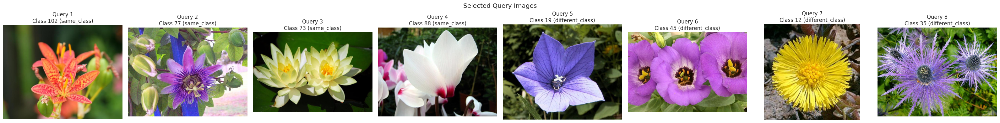

In [15]:
# Select query images for explanation
def select_query_images(image_df, selected_classes, num_queries=2, split='test'):
    """Select query images for explanation, ensuring diverse classes."""
    
    query_images = []
    split_df = image_df[image_df['split'] == split].copy()
    
    # Select some images from concept classes
    for class_label in selected_classes[:num_queries]:
        class_images = split_df[split_df['label'] == class_label]
        if len(class_images) > 1:  # Make sure we don't select concept images
            query_img = class_images.sample(1).iloc[0]
            query_images.append({
                'path': query_img['path'],
                'label': query_img['label'],
                'type': 'same_class'
            })
    
    # Select some images from different classes
    other_classes = [cls for cls in split_df['label'].unique() if cls not in selected_classes]
    if other_classes:
        for _ in range(num_queries):
            random_class = np.random.choice(other_classes)
            class_images = split_df[split_df['label'] == random_class]
            if len(class_images) > 0:
                query_img = class_images.sample(1).iloc[0]
                query_images.append({
                    'path': query_img['path'],
                    'label': query_img['label'],
                    'type': 'different_class'
                })
    
    # Prepare query image data
    for query in query_images:
        img_array, img_float, img_tensor = prepare_image(query['path'])
        query['array'] = img_array
        query['float'] = img_float
        query['tensor'] = img_tensor
    
    return query_images

# Select query images
query_images = select_query_images(image_df, selected_classes, num_queries=CONFIG['num_samples']//2)

print(f"Selected {len(query_images)} query images:")
for i, query in enumerate(query_images):
    print(f"  Query {i+1}: Class {query['label']} ({query['type']})")

# Visualize query images
fig, axes = plt.subplots(1, len(query_images), figsize=(4*len(query_images), 4))
if len(query_images) == 1:
    axes = [axes]

for idx, query in enumerate(query_images):
    axes[idx].imshow(query['array'])
    axes[idx].set_title(f"Query {idx+1}\nClass {query['label']} ({query['type']})")
    axes[idx].axis('off')

plt.suptitle('Selected Query Images')
plt.tight_layout()
plt.show()

In [34]:
# Generate Concept Activation Maps for all model-concept-query combinations
def generate_all_concept_cams(models, concept_embeddings, query_images, selected_classes, 
                             cam_method='GradCAM'):
    """Generate CAMs for all combinations of models, concepts, and queries."""
    
    all_cams = {}
    
    for model_name, model in models.items():
        print(f"\nGenerating CAMs for {model_name}...")
        all_cams[model_name] = {}
        
        # Determine model type
        if 'center_loss' in model_name:
            model_type = 'center_loss'
        elif 'siamese' in model_name:
            model_type = 'siamese'
        elif 'triplet' in model_name:
            model_type = 'triplet'
        else:
            model_type = 'unknown'
            print(model_type)
        
        for query_idx, query in enumerate(query_images):
            all_cams[model_name][f'query_{query_idx}'] = {
                'query_info': query,
                'similarity_cams': {},
                'dissimilarity_cams': {}
            }
            
            for concept_class in selected_classes:
                concept_embedding = concept_embeddings[model_name][concept_class]
                
                # Generate similarity CAM
                try:
                    sim_cam = generate_concept_cam(
                        model, model_type, query['tensor'], 
                        concept_embedding, cam_method, similarity=True
                    )
                    all_cams[model_name][f'query_{query_idx}']['similarity_cams'][concept_class] = sim_cam
                except Exception as e:
                    print(f"Error generating similarity CAM for {model_name}, query {query_idx}, concept {concept_class}: {e}")
                    all_cams[model_name][f'query_{query_idx}']['similarity_cams'][concept_class] = np.zeros((224, 224))
                
                # Generate dissimilarity CAM
                try:
                    dissim_cam = generate_concept_cam(
                        model, model_type, query['tensor'], 
                        concept_embedding, cam_method, similarity=False
                    )
                    all_cams[model_name][f'query_{query_idx}']['dissimilarity_cams'][concept_class] = dissim_cam
                except Exception as e:
                    print(f"Error generating dissimilarity CAM for {model_name}, query {query_idx}, concept {concept_class}: {e}")
                    all_cams[model_name][f'query_{query_idx}']['dissimilarity_cams'][concept_class] = np.zeros((224, 224))
                    
    return all_cams

# Generate CAMs (limit combinations to avoid memory issues)
print("Generating Concept Activation Maps...")
print("This may take several minutes...")

all_cams = generate_all_concept_cams(
    models, concept_embeddings, query_images[:2], selected_classes[:2], cam_method='GradCAM'
)

print("CAM generation complete!")

Generating Concept Activation Maps...
This may take several minutes...

Generating CAMs for center_loss...

Generating CAMs for siamese...

Generating CAMs for triplet...

Generating CAMs for robust_center_loss...

Generating CAMs for robust_siamese...

Generating CAMs for robust_triplet...
CAM generation complete!


## Section 6: Visualize Concept Activation Maps

Let's create comprehensive visualizations of our concept activation maps to understand model behavior.


=== Visualizing Query 1 ===
Saved visualization to explanations/query_1_cams.png


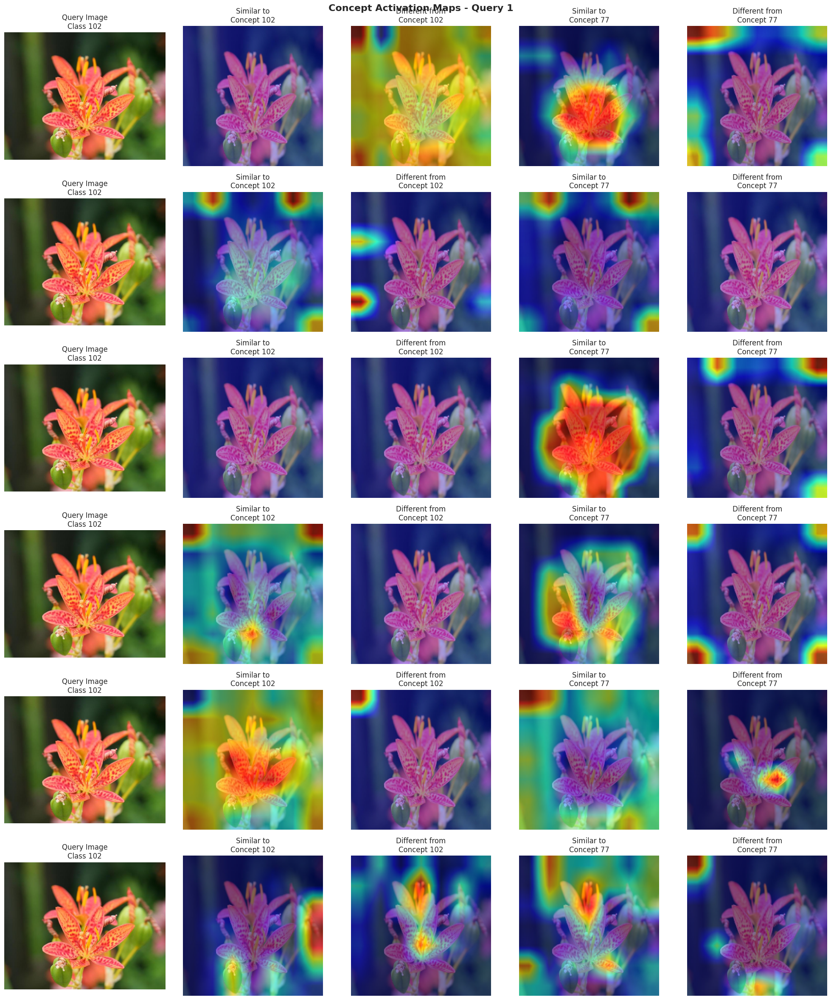


=== Visualizing Query 2 ===
Saved visualization to explanations/query_2_cams.png


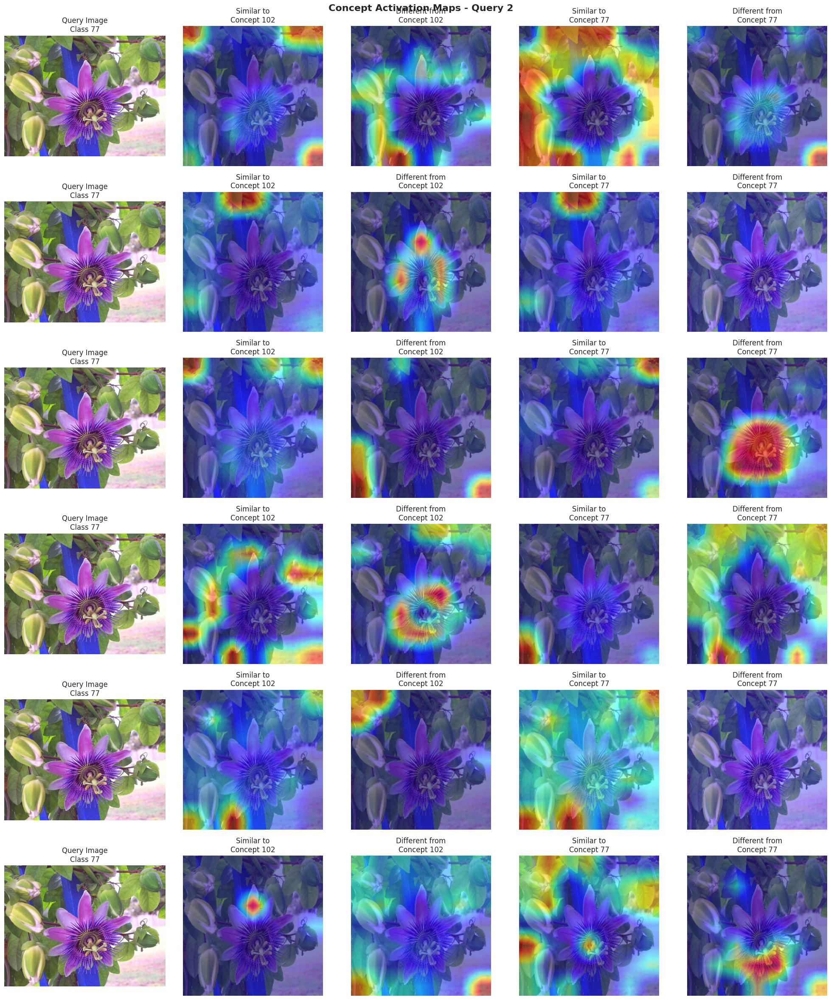


=== Comparing Original vs Robust Models ===


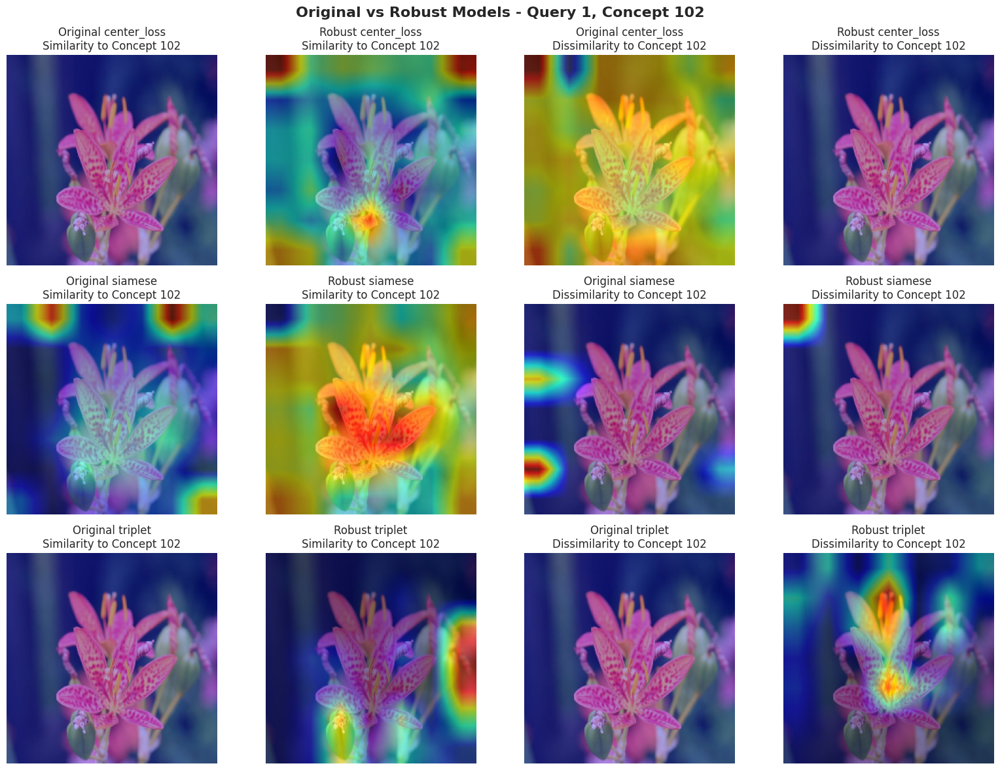

In [35]:
# Comprehensive CAM visualization functions
def visualize_concept_activations(all_cams, concept_images, selected_classes, query_idx=0, save_path=None):
    """Visualize concept activations for a specific query across all models."""
    
    model_names = list(all_cams.keys())
    num_concepts = len(selected_classes)
    
    # Create figure: rows = models, cols = [query, concept1_sim, concept1_dissim, concept2_sim, concept2_dissim, ...]
    cols = 1 + (num_concepts * 2)  # query + similarity/dissimilarity for each concept
    fig, axes = plt.subplots(len(model_names), cols, figsize=(4*cols, 4*len(model_names)))
    
    if len(model_names) == 1:
        axes = axes.reshape(1, -1)
    if cols == 1:
        axes = axes.reshape(-1, 1)
    
    query_key = f'query_{query_idx}'
    query_info = all_cams[model_names[0]][query_key]['query_info']
    
    for row, model_name in enumerate(model_names):
        # Show query image
        axes[row, 0].imshow(query_info['array'])
        axes[row, 0].set_title(f'Query Image\nClass {query_info["label"]}')
        axes[row, 0].axis('off')
        
        col = 1
        for concept_class in selected_classes:
            # Similarity CAM
            if concept_class in all_cams[model_name][query_key]['similarity_cams']:
                sim_cam = all_cams[model_name][query_key]['similarity_cams'][concept_class]
                
                # Overlay CAM on image
                cam_image = show_cam_on_image(query_info['float'], sim_cam, use_rgb=True)
                axes[row, col].imshow(cam_image)
                axes[row, col].set_title(f'Similar to\nConcept {concept_class}')
                axes[row, col].axis('off')
            
            col += 1
            
            # Dissimilarity CAM
            if concept_class in all_cams[model_name][query_key]['dissimilarity_cams']:
                dissim_cam = all_cams[model_name][query_key]['dissimilarity_cams'][concept_class]
                
                # Overlay CAM on image
                cam_image = show_cam_on_image(query_info['float'], dissim_cam, use_rgb=True)
                axes[row, col].imshow(cam_image)
                axes[row, col].set_title(f'Different from\nConcept {concept_class}')
                axes[row, col].axis('off')
            
            col += 1
        
        # Add model name as y-label
        axes[row, 0].set_ylabel(f'{model_name.replace("_", " ").title()}', fontsize=12, fontweight='bold')
    
    plt.suptitle(f'Concept Activation Maps - Query {query_idx + 1}', fontsize=16, fontweight='bold')
    plt.tight_layout()
    
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        print(f"Saved visualization to {save_path}")
    
    plt.show()

def compare_original_vs_robust(all_cams, concept_images, selected_classes, query_idx=0, concept_class=None):
    """Compare concept activations between original and robust models."""
    
    if concept_class is None:
        concept_class = selected_classes[0]
    
    # Get model pairs
    model_pairs = []
    for model_name in all_cams.keys():
        if not model_name.startswith('robust_'):
            robust_name = f'robust_{model_name}'
            if robust_name in all_cams:
                model_pairs.append((model_name, robust_name))
    
    query_key = f'query_{query_idx}'
    query_info = list(all_cams.values())[0][query_key]['query_info']
    
    fig, axes = plt.subplots(len(model_pairs), 4, figsize=(16, 4*len(model_pairs)))
    if len(model_pairs) == 1:
        axes = axes.reshape(1, -1)
    
    for row, (orig_name, robust_name) in enumerate(model_pairs):
        # Original similarity
        orig_sim_cam = all_cams[orig_name][query_key]['similarity_cams'].get(concept_class, np.zeros((224, 224)))
        cam_image = show_cam_on_image(query_info['float'], orig_sim_cam, use_rgb=True)
        axes[row, 0].imshow(cam_image)
        axes[row, 0].set_title(f'Original {orig_name}\nSimilarity to Concept {concept_class}')
        axes[row, 0].axis('off')
        
        # Robust similarity
        robust_sim_cam = all_cams[robust_name][query_key]['similarity_cams'].get(concept_class, np.zeros((224, 224)))
        cam_image = show_cam_on_image(query_info['float'], robust_sim_cam, use_rgb=True)
        axes[row, 1].imshow(cam_image)
        axes[row, 1].set_title(f'Robust {robust_name.replace("robust_", "")}\nSimilarity to Concept {concept_class}')
        axes[row, 1].axis('off')
        
        # Original dissimilarity
        orig_dissim_cam = all_cams[orig_name][query_key]['dissimilarity_cams'].get(concept_class, np.zeros((224, 224)))
        cam_image = show_cam_on_image(query_info['float'], orig_dissim_cam, use_rgb=True)
        axes[row, 2].imshow(cam_image)
        axes[row, 2].set_title(f'Original {orig_name}\nDissimilarity to Concept {concept_class}')
        axes[row, 2].axis('off')
        
        # Robust dissimilarity
        robust_dissim_cam = all_cams[robust_name][query_key]['dissimilarity_cams'].get(concept_class, np.zeros((224, 224)))
        cam_image = show_cam_on_image(query_info['float'], robust_dissim_cam, use_rgb=True)
        axes[row, 3].imshow(cam_image)
        axes[row, 3].set_title(f'Robust {robust_name.replace("robust_", "")}\nDissimilarity to Concept {concept_class}')
        axes[row, 3].axis('off')
    
    plt.suptitle(f'Original vs Robust Models - Query {query_idx + 1}, Concept {concept_class}', 
                 fontsize=16, fontweight='bold')
    plt.tight_layout()
    plt.show()

# Generate visualizations for all queries
for query_idx in range(min(2, len(query_images))):
    print(f"\n=== Visualizing Query {query_idx + 1} ===")
    visualize_concept_activations(all_cams, concept_images, selected_classes[:2], 
                                 query_idx=query_idx,
                                 save_path=os.path.join(CONFIG['explanation_dir'], f'query_{query_idx+1}_cams.png'))

# Compare original vs robust models
print(f"\n=== Comparing Original vs Robust Models ===")
compare_original_vs_robust(all_cams, concept_images, selected_classes[:2], query_idx=0)

## Section 7: Quantitative Analysis of Explanations

Let's perform quantitative analysis of the concept activation maps to understand differences between models.

In [36]:
# Quantitative analysis of concept activation maps
def analyze_cam_statistics(all_cams):
    """Compute statistics for concept activation maps."""
    
    stats = {}
    
    for model_name, model_cams in all_cams.items():
        stats[model_name] = {
            'similarity_stats': {},
            'dissimilarity_stats': {},
            'focus_concentration': {},
            'activation_strength': {}
        }
        
        sim_values = []
        dissim_values = []
        concentration_values = []
        strength_values = []
        
        for query_key, query_data in model_cams.items():
            for concept_class, cam in query_data['similarity_cams'].items():
                if cam.size > 0:
                    # Basic statistics
                    sim_values.extend(cam.flatten())
                    
                    # Concentration (entropy-based measure)
                    cam_norm = cam / (cam.sum() + 1e-8)
                    entropy = -np.sum(cam_norm * np.log(cam_norm + 1e-8))
                    concentration_values.append(entropy)
                    
                    # Activation strength (top 10% mean)
                    top_10_percent = np.percentile(cam, 90)
                    strength_values.append(top_10_percent)
            
            for concept_class, cam in query_data['dissimilarity_cams'].items():
                if cam.size > 0:
                    dissim_values.extend(cam.flatten())
        
        # Aggregate statistics
        if sim_values:
            stats[model_name]['similarity_stats'] = {
                'mean': np.mean(sim_values),
                'std': np.std(sim_values),
                'max': np.max(sim_values),
                'min': np.min(sim_values)
            }
        
        if dissim_values:
            stats[model_name]['dissimilarity_stats'] = {
                'mean': np.mean(dissim_values),
                'std': np.std(dissim_values),
                'max': np.max(dissim_values),
                'min': np.min(dissim_values)
            }
        
        if concentration_values:
            stats[model_name]['focus_concentration'] = {
                'mean': np.mean(concentration_values),
                'std': np.std(concentration_values)
            }
        
        if strength_values:
            stats[model_name]['activation_strength'] = {
                'mean': np.mean(strength_values),
                'std': np.std(strength_values)
            }
    
    return stats

def compute_cam_similarity(cam1, cam2):
    """Compute similarity between two CAMs using various metrics."""
    
    if cam1.shape != cam2.shape:
        return {'error': 'Shape mismatch'}
    
    # Flatten CAMs
    cam1_flat = cam1.flatten()
    cam2_flat = cam2.flatten()
    
    # Correlation
    correlation = np.corrcoef(cam1_flat, cam2_flat)[0, 1]
    
    # Cosine similarity
    cosine_sim = np.dot(cam1_flat, cam2_flat) / (np.linalg.norm(cam1_flat) * np.linalg.norm(cam2_flat) + 1e-8)
    
    # Structural similarity (simplified version)
    mse = np.mean((cam1_flat - cam2_flat) ** 2)
    max_val = max(np.max(cam1_flat), np.max(cam2_flat))
    psnr = 20 * np.log10(max_val / (np.sqrt(mse) + 1e-8))
    
    return {
        'correlation': correlation,
        'cosine_similarity': cosine_sim,
        'mse': mse,
        'psnr': psnr
    }

def compare_original_vs_robust_cams(all_cams):
    """Compare CAMs between original and robust models."""
    
    comparisons = {}
    
    for model_name in all_cams.keys():
        if not model_name.startswith('robust_'):
            robust_name = f'robust_{model_name}'
            if robust_name in all_cams:
                comparisons[model_name] = {
                    'similarity_comparisons': [],
                    'dissimilarity_comparisons': []
                }
                
                # Compare across all queries and concepts
                for query_key in all_cams[model_name].keys():
                    if query_key in all_cams[robust_name]:
                        orig_query = all_cams[model_name][query_key]
                        robust_query = all_cams[robust_name][query_key]
                        
                        # Compare similarity CAMs
                        for concept_class in orig_query['similarity_cams'].keys():
                            if concept_class in robust_query['similarity_cams']:
                                orig_cam = orig_query['similarity_cams'][concept_class]
                                robust_cam = robust_query['similarity_cams'][concept_class]
                                
                                similarity = compute_cam_similarity(orig_cam, robust_cam)
                                similarity['concept_class'] = concept_class
                                similarity['query'] = query_key
                                comparisons[model_name]['similarity_comparisons'].append(similarity)
                        
                        # Compare dissimilarity CAMs
                        for concept_class in orig_query['dissimilarity_cams'].keys():
                            if concept_class in robust_query['dissimilarity_cams']:
                                orig_cam = orig_query['dissimilarity_cams'][concept_class]
                                robust_cam = robust_query['dissimilarity_cams'][concept_class]
                                
                                similarity = compute_cam_similarity(orig_cam, robust_cam)
                                similarity['concept_class'] = concept_class
                                similarity['query'] = query_key
                                comparisons[model_name]['dissimilarity_comparisons'].append(similarity)
    
    return comparisons

# Perform quantitative analysis
print("Computing CAM statistics...")
cam_stats = analyze_cam_statistics(all_cams)

print("Comparing original vs robust models...")
cam_comparisons = compare_original_vs_robust_cams(all_cams)

# Display results
print("\n=== CAM Statistics Summary ===")
for model_name, stats in cam_stats.items():
    print(f"\n{model_name.replace('_', ' ').title()}:")
    
    if 'similarity_stats' in stats and stats['similarity_stats']:
        sim_stats = stats['similarity_stats']
        print(f"  Similarity CAM - Mean: {sim_stats['mean']:.4f}, Std: {sim_stats['std']:.4f}")
    
    if 'focus_concentration' in stats and stats['focus_concentration']:
        conc_stats = stats['focus_concentration']
        print(f"  Focus Concentration - Mean: {conc_stats['mean']:.4f}, Std: {conc_stats['std']:.4f}")
    
    if 'activation_strength' in stats and stats['activation_strength']:
        strength_stats = stats['activation_strength']
        print(f"  Activation Strength - Mean: {strength_stats['mean']:.4f}, Std: {strength_stats['std']:.4f}")

print("\n=== Original vs Robust Comparison Summary ===")
for model_name, comp_data in cam_comparisons.items():
    print(f"\n{model_name.replace('_', ' ').title()}:")
    
    if comp_data['similarity_comparisons']:
        correlations = [c['correlation'] for c in comp_data['similarity_comparisons'] if not np.isnan(c.get('correlation', np.nan))]
        if correlations:
            print(f"  Similarity CAM correlation with robust version: {np.mean(correlations):.4f} ± {np.std(correlations):.4f}")
    
    if comp_data['dissimilarity_comparisons']:
        correlations = [c['correlation'] for c in comp_data['dissimilarity_comparisons'] if not np.isnan(c.get('correlation', np.nan))]
        if correlations:
            print(f"  Dissimilarity CAM correlation with robust version: {np.mean(correlations):.4f} ± {np.std(correlations):.4f}")

Computing CAM statistics...
Comparing original vs robust models...

=== CAM Statistics Summary ===

Center Loss:
  Similarity CAM - Mean: 0.2083, Std: 0.2761
  Focus Concentration - Mean: 7.7120, Std: 4.4547
  Activation Strength - Mean: 0.4988, Std: 0.3253

Siamese:
  Similarity CAM - Mean: 0.1768, Std: 0.1657
  Focus Concentration - Mean: 10.4804, Std: 0.0816
  Activation Strength - Mean: 0.3317, Std: 0.0838

Triplet:
  Similarity CAM - Mean: 0.1723, Std: 0.2632
  Focus Concentration - Mean: 7.6989, Std: 4.4508
  Activation Strength - Mean: 0.3600, Std: 0.3400

Robust Center Loss:
  Similarity CAM - Mean: 0.2312, Std: 0.2226
  Focus Concentration - Mean: 10.2676, Std: 0.3725
  Activation Strength - Mean: 0.4755, Std: 0.1795

Robust Siamese:
  Similarity CAM - Mean: 0.3839, Std: 0.2009
  Focus Concentration - Mean: 10.7161, Std: 0.0694
  Activation Strength - Mean: 0.5454, Std: 0.1436

Robust Triplet:
  Similarity CAM - Mean: 0.1887, Std: 0.2178
  Focus Concentration - Mean: 9.8931, S

## Section 8: Cross-Model Explanation Comparison

Let's compare how different models focus on different parts of the same image for the same concepts.

Creating model comparison visualizations...


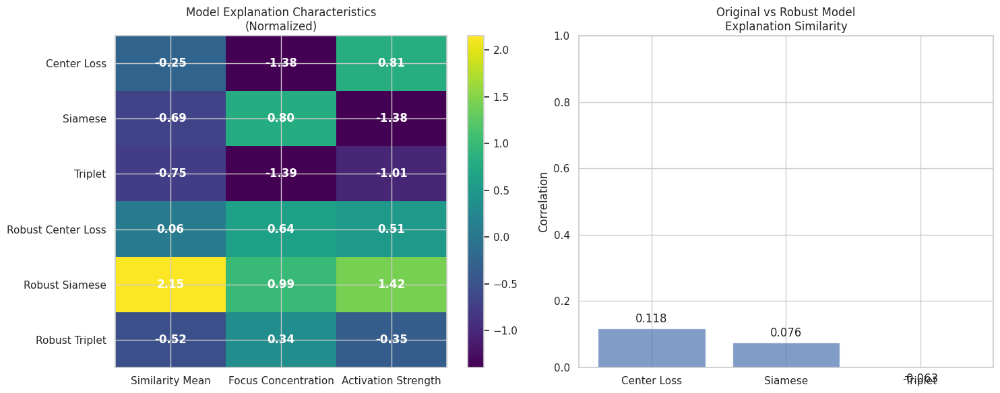


Analyzing attention overlap between models...


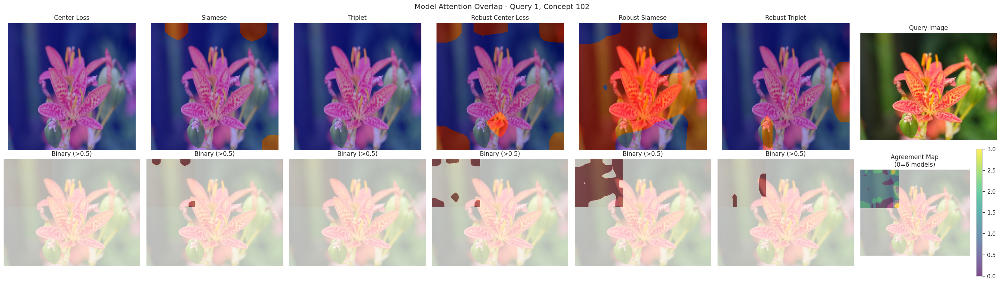

In [37]:
# Cross-model explanation comparison
def create_model_comparison_heatmap(cam_stats, cam_comparisons):
    """Create heatmaps comparing model explanation patterns."""
    
    # Extract metrics for visualization
    model_names = list(cam_stats.keys())
    metrics = ['similarity_mean', 'focus_concentration', 'activation_strength', 'orig_robust_correlation']
    
    data_matrix = []
    
    for model_name in model_names:
        row = []
        
        # Similarity mean
        if 'similarity_stats' in cam_stats[model_name] and cam_stats[model_name]['similarity_stats']:
            row.append(cam_stats[model_name]['similarity_stats']['mean'])
        else:
            row.append(0)
        
        # Focus concentration
        if 'focus_concentration' in cam_stats[model_name] and cam_stats[model_name]['focus_concentration']:
            row.append(cam_stats[model_name]['focus_concentration']['mean'])
        else:
            row.append(0)
        
        # Activation strength
        if 'activation_strength' in cam_stats[model_name] and cam_stats[model_name]['activation_strength']:
            row.append(cam_stats[model_name]['activation_strength']['mean'])
        else:
            row.append(0)
        
        # Original vs robust correlation
        base_model = model_name.replace('robust_', '')
        if base_model in cam_comparisons and cam_comparisons[base_model]['similarity_comparisons']:
            correlations = [c['correlation'] for c in cam_comparisons[base_model]['similarity_comparisons'] 
                          if not np.isnan(c.get('correlation', np.nan))]
            row.append(np.mean(correlations) if correlations else 0)
        else:
            row.append(0 if 'robust' in model_name else np.nan)
        
        data_matrix.append(row)
    
    # Create heatmap
    fig, axes = plt.subplots(1, 2, figsize=(15, 6))
    
    # Model characteristics heatmap
    data_matrix_array = np.array(data_matrix)
    
    # Normalize each metric column for better visualization
    for col in range(data_matrix_array.shape[1] - 1):  # Skip correlation column
        column = data_matrix_array[:, col]
        if np.std(column) > 0:
            data_matrix_array[:, col] = (column - np.mean(column)) / np.std(column)
    
    im1 = axes[0].imshow(data_matrix_array[:, :3], cmap='viridis', aspect='auto')
    axes[0].set_xticks(range(3))
    axes[0].set_xticklabels(['Similarity Mean', 'Focus Concentration', 'Activation Strength'])
    axes[0].set_yticks(range(len(model_names)))
    axes[0].set_yticklabels([name.replace('_', ' ').title() for name in model_names])
    axes[0].set_title('Model Explanation Characteristics\n(Normalized)')
    
    # Add text annotations
    for i in range(len(model_names)):
        for j in range(3):
            text = axes[0].text(j, i, f'{data_matrix_array[i, j]:.2f}',
                               ha="center", va="center", color="white", fontweight="bold")
    
    plt.colorbar(im1, ax=axes[0])
    
    # Original vs Robust similarity
    orig_models = [name for name in model_names if not name.startswith('robust_')]
    robust_correlations = []
    
    for orig_model in orig_models:
        if orig_model in cam_comparisons and cam_comparisons[orig_model]['similarity_comparisons']:
            correlations = [c['correlation'] for c in cam_comparisons[orig_model]['similarity_comparisons'] 
                          if not np.isnan(c.get('correlation', np.nan))]
            robust_correlations.append(np.mean(correlations) if correlations else 0)
        else:
            robust_correlations.append(0)
    
    if robust_correlations:
        bars = axes[1].bar(range(len(orig_models)), robust_correlations, alpha=0.7)
        axes[1].set_xticks(range(len(orig_models)))
        axes[1].set_xticklabels([name.replace('_', ' ').title() for name in orig_models])
        axes[1].set_ylabel('Correlation')
        axes[1].set_title('Original vs Robust Model\nExplanation Similarity')
        axes[1].set_ylim(0, 1)
        
        # Add value labels on bars
        for i, bar in enumerate(bars):
            height = bar.get_height()
            axes[1].text(bar.get_x() + bar.get_width()/2., height + 0.01,
                        f'{height:.3f}', ha='center', va='bottom')
    
    plt.tight_layout()
    plt.show()

def visualize_attention_overlap(all_cams, query_idx=0, concept_class=None, threshold=0.5):
    """Visualize where different models agree/disagree on attention."""
    
    if concept_class is None:
        concept_class = selected_classes[0]
    
    query_key = f'query_{query_idx}'
    query_info = list(all_cams.values())[0][query_key]['query_info']
    
    # Get similarity CAMs for all models
    model_cams = {}
    for model_name, model_data in all_cams.items():
        if query_key in model_data and concept_class in model_data[query_key]['similarity_cams']:
            cam = model_data[query_key]['similarity_cams'][concept_class]
            # Threshold the CAM
            cam_binary = (cam > threshold).astype(int)
            model_cams[model_name] = cam_binary
    
    if len(model_cams) < 2:
        print("Need at least 2 models for overlap analysis")
        return
    
    # Create agreement map
    model_names = list(model_cams.keys())
    cam_stack = np.stack(list(model_cams.values()), axis=0)
    agreement_map = np.sum(cam_stack, axis=0)
    
    # Visualization
    fig, axes = plt.subplots(2, len(model_names) + 1, figsize=(4*(len(model_names)+1), 8))
    
    # Show individual model attention
    for i, (model_name, cam) in enumerate(model_cams.items()):
        # Original attention
        axes[0, i].imshow(show_cam_on_image(query_info['float'], cam, use_rgb=True))
        axes[0, i].set_title(f'{model_name.replace("_", " ").title()}')
        axes[0, i].axis('off')
        
        # Binary attention
        axes[1, i].imshow(cam, cmap='Reds', alpha=0.7)
        axes[1, i].imshow(query_info['array'], alpha=0.3)
        axes[1, i].set_title(f'Binary (>{threshold})')
        axes[1, i].axis('off')
    
    # Show agreement map
    axes[0, -1].imshow(query_info['array'])
    axes[0, -1].set_title('Query Image')
    axes[0, -1].axis('off')
    
    im = axes[1, -1].imshow(agreement_map, cmap='viridis', alpha=0.7)
    axes[1, -1].imshow(query_info['array'], alpha=0.3)
    axes[1, -1].set_title(f'Agreement Map\n(0={len(model_names)} models)')
    axes[1, -1].axis('off')
    
    plt.colorbar(im, ax=axes[1, -1])
    plt.suptitle(f'Model Attention Overlap - Query {query_idx+1}, Concept {concept_class}')
    plt.tight_layout()
    plt.show()

# Generate cross-model comparisons
print("Creating model comparison visualizations...")

# Model characteristics heatmap
create_model_comparison_heatmap(cam_stats, cam_comparisons)

# Attention overlap analysis
print("\nAnalyzing attention overlap between models...")
visualize_attention_overlap(all_cams, query_idx=0, concept_class=selected_classes[0], threshold=0.5)

## Section 9: Classification vs Similarity Explanations

Let's compare traditional classification explanations with our concept-based similarity explanations for the Center Loss model.

Comparing classification and similarity explanations...

=== Query 1 Analysis ===


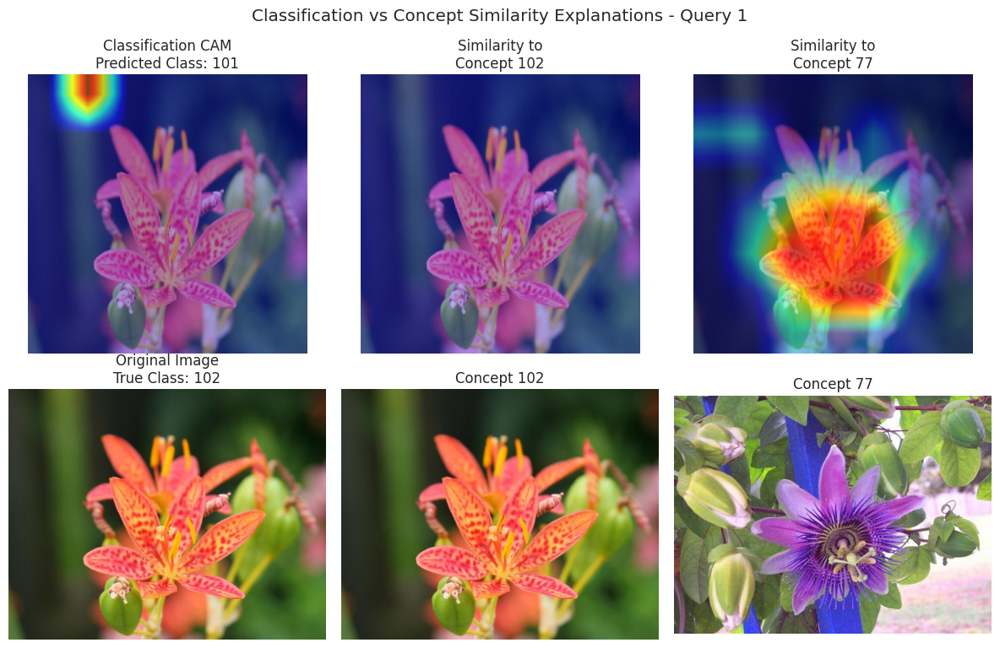


Quantitative Analysis for Query 1:
True class: 102, Predicted class: 101
Classification accuracy: Incorrect

CAM Similarities with Classification CAM:
  Concept 102: Correlation = nan, Cosine Similarity = 0.000
  Concept 77: Correlation = -0.138, Cosine Similarity = 0.022

=== Query 2 Analysis ===


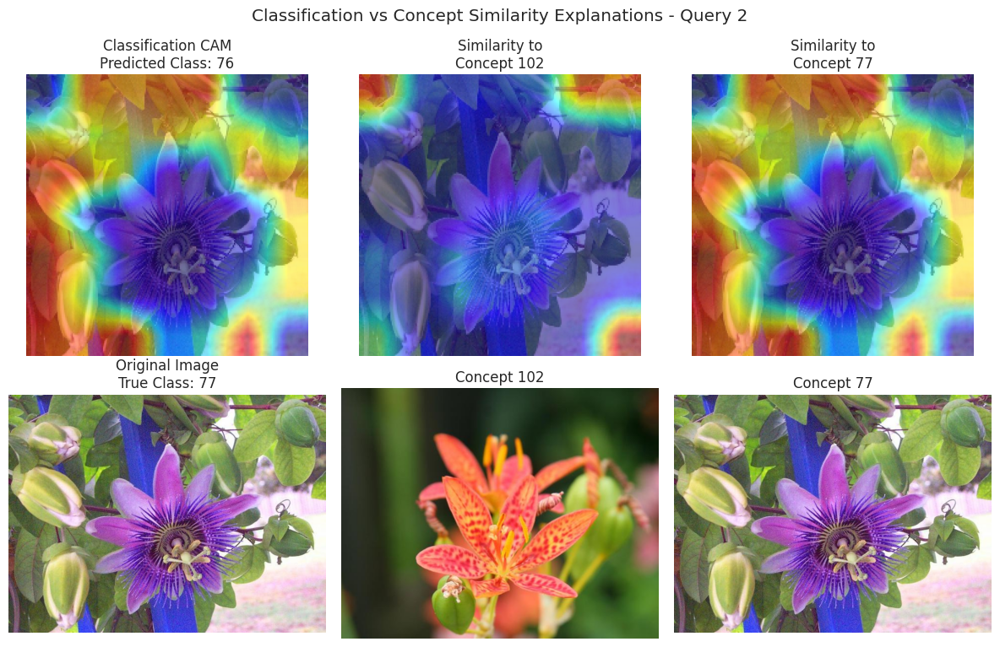


Quantitative Analysis for Query 2:
True class: 77, Predicted class: 76
Classification accuracy: Incorrect

CAM Similarities with Classification CAM:
  Concept 102: Correlation = -0.349, Cosine Similarity = 0.355
  Concept 77: Correlation = 0.997, Cosine Similarity = 0.999


In [38]:
# Compare classification and similarity explanations
def compare_classification_vs_similarity_explanations(center_model, query_images, selected_classes, 
                                                     concept_embeddings, query_idx=0):
    """Compare traditional classification CAMs with concept similarity CAMs."""
    
    query = query_images[query_idx]
    query_tensor = query['tensor'].to(CONFIG['device'])
    
    # Generate classification CAM (traditional approach)
    predicted_class = None
    with torch.no_grad():
        logits, _ = center_model(query_tensor)
        predicted_class = torch.argmax(logits, dim=1).item()
    
    # Generate classification CAM
    classification_cam = generate_classification_cam(
        center_model, query_tensor, predicted_class, 'GradCAM'
    )
    
    # Generate concept similarity CAMs
    concept_cams = {}
    for concept_class in selected_classes:
        concept_embedding = concept_embeddings['center_loss'][concept_class]
        concept_cam = generate_concept_cam(
            center_model, 'center_loss', query_tensor, 
            concept_embedding, 'GradCAM', similarity=True
        )
        concept_cams[concept_class] = concept_cam
    
    # Visualization
    n_concepts = len(selected_classes)
    fig, axes = plt.subplots(2, n_concepts + 1, figsize=(4*(n_concepts+1), 8))
    
    # Classification explanation
    class_cam_image = show_cam_on_image(query['float'], classification_cam, use_rgb=True)
    axes[0, 0].imshow(class_cam_image)
    axes[0, 0].set_title(f'Classification CAM\nPredicted Class: {predicted_class}')
    axes[0, 0].axis('off')
    
    axes[1, 0].imshow(query['array'])
    axes[1, 0].set_title(f'Original Image\nTrue Class: {query["label"]}')
    axes[1, 0].axis('off')
    
    # Concept similarity explanations
    for i, (concept_class, concept_cam) in enumerate(concept_cams.items()):
        concept_cam_image = show_cam_on_image(query['float'], concept_cam, use_rgb=True)
        axes[0, i+1].imshow(concept_cam_image)
        axes[0, i+1].set_title(f'Similarity to\nConcept {concept_class}')
        axes[0, i+1].axis('off')
        
        # Show concept image
        concept_img = concept_images[concept_class]['images'][0]['array']
        axes[1, i+1].imshow(concept_img)
        axes[1, i+1].set_title(f'Concept {concept_class}')
        axes[1, i+1].axis('off')
    
    plt.suptitle(f'Classification vs Concept Similarity Explanations - Query {query_idx+1}')
    plt.tight_layout()
    plt.show()
    
    # Quantitative comparison
    print(f"\nQuantitative Analysis for Query {query_idx+1}:")
    print(f"True class: {query['label']}, Predicted class: {predicted_class}")
    print(f"Classification accuracy: {'Correct' if query['label'] == predicted_class else 'Incorrect'}")
    
    # Compute similarity between classification CAM and concept CAMs
    print("\nCAM Similarities with Classification CAM:")
    for concept_class, concept_cam in concept_cams.items():
        similarity_metrics = compute_cam_similarity(classification_cam, concept_cam)
        print(f"  Concept {concept_class}: Correlation = {similarity_metrics['correlation']:.3f}, "
              f"Cosine Similarity = {similarity_metrics['cosine_similarity']:.3f}")

# Generate classification vs similarity comparison
print("Comparing classification and similarity explanations...")

# Only for Center Loss models (classification capable)
for query_idx in range(min(2, len(query_images))):
    print(f"\n=== Query {query_idx + 1} Analysis ===")
    compare_classification_vs_similarity_explanations(
        center_loss_model, query_images, selected_classes[:2], 
        concept_embeddings, query_idx=query_idx
    )